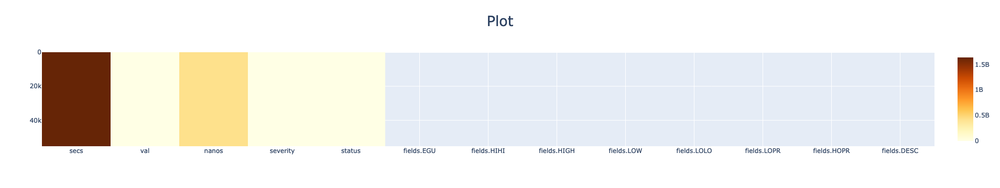

In [8]:
import plotly.express as px
import pandas as pd

# Data put together by Gabe Salzer on data.world
# Data source: http://www.landofbasketball.com/nba_teams_year_by_year.htm

json_data = pd.read_json('/Users/nicenoize/Documents/Master/Projekt/example.json')
json_list = json_data["data"][0]
df = pd.json_normalize(json_list)

fig = px.imshow(df, color_continuous_scale=px.colors.sequential.YlOrBr,
                title="Plot")
fig.update_layout(title_font={'size':27}, title_x=0.5)
fig.update_traces(hoverongaps=False,
                  hovertemplate="Team: %{y}"
                                "<br>Year: %{x}"
                                "<br>Winning %: %{z}<extra></extra>"
                  )



In [3]:
json_data = pd.read_json('/Users/nicenoize/Documents/Master/Projekt/example.json')
json_list = json_data["data"][0]
df = pd.json_normalize(json_list)
#sd = dd.from_pandas(df, npartitions=3)

In [4]:
df.head()

,secs,val,nanos,severity,status,fields.EGU,fields.HIHI,fields.HIGH,fields.LOW,fields.LOLO,fields.LOPR,fields.HOPR,fields.DESC
0,1637230732,0.005394,424198978,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1637230733,0.005400,424106948,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1637230734,0.005403,423817146,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1637230736,0.005400,424075456,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1637230737,0.005403,424125840,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


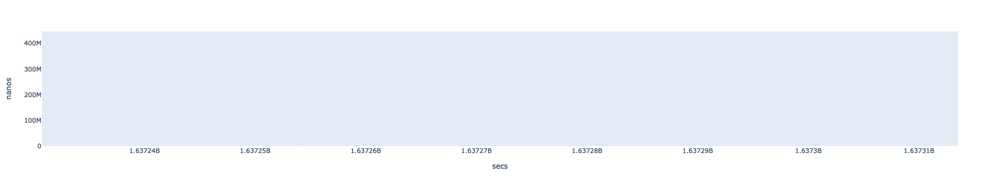

In [9]:
import plotly.express as px
import pandas as pd

json_data = pd.read_json('/Users/nicenoize/Documents/Master/Projekt/example.json')
json_list = json_data["data"][0]
df = pd.json_normalize(json_list)

fig = px.bar(df, x=df.secs, y=df.nanos)
fig.show()

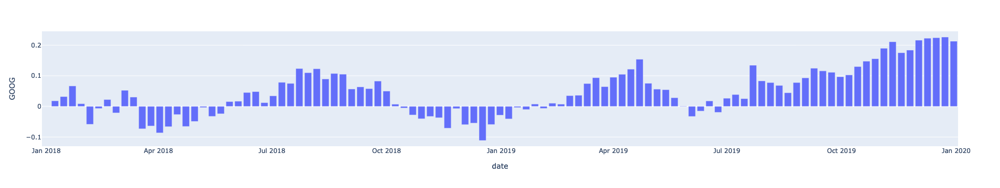

In [5]:
import plotly.express as px

df = px.data.stocks(indexed=True)-1
fig = px.bar(df, x=df.index, y="GOOG")
fig.show()

In [7]:
df.head()

company,GOOG,AAPL,AMZN,FB,NFLX,MSFT
date,,,,,,
2018-01-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2018-01-08,0.018172,0.011943,0.061881,-0.040032,0.053526,0.015988
2018-01-15,0.032008,0.019771,0.053240,-0.029757,0.049860,0.020524
2018-01-22,0.066783,-0.019943,0.140676,0.016858,0.307681,0.066561
2018-01-29,0.008773,-0.082857,0.163374,0.018357,0.273537,0.040708


In [ ]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np
# Read data from a csv
json_data = pd.read_json('/Users/nicenoize/Documents/Master/Projekt/example.json')
json_list = json_data["data"][0]
z_data = pd.json_normalize(json_list)

z = z_data.nanos.astype(int).tolist()
sh_0 = z_data.secs.max() #.astype(int)
sh_1 = int(z_data.val.max())
type(sh_0)
x, y = np.linspace(0, 1, sh_0), np.linspace(0, 1, sh_1)
fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])
fig.update_layout(title='Mt Bruno Elevation', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

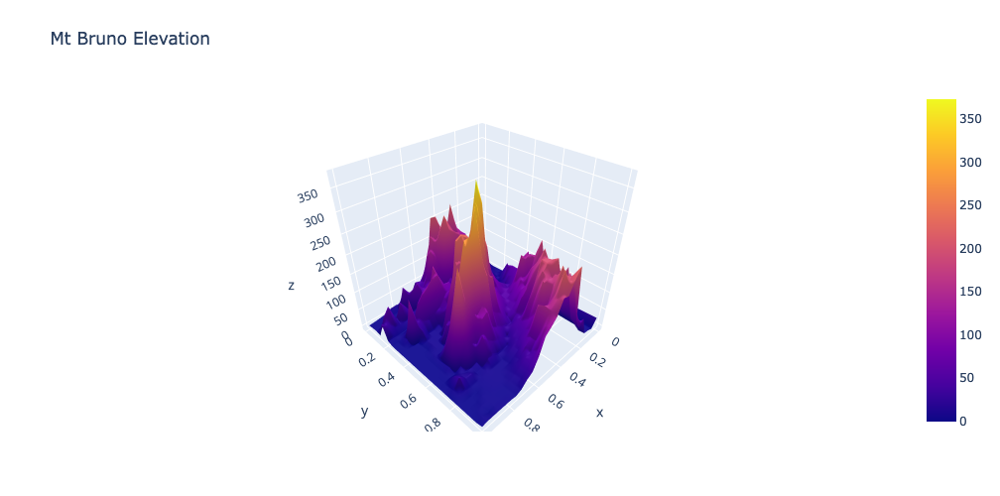

In [1]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np
# Read data from a csv
z_data = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/api_docs/mt_bruno_elevation.csv')
z = z_data.values
sh_0, sh_1 = z.shape
x, y = np.linspace(0, 1, sh_0), np.linspace(0, 1, sh_1)
fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])
fig.update_layout(title='Mt Bruno Elevation', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

In [1]:
import json

import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
import plotly.express as px
import pandas as pd

external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']

app = dash.Dash(__name__, external_stylesheets=external_stylesheets)

styles = {
    'pre': {
        'border': 'thin lightgrey solid',
        'overflowX': 'scroll'
    }
}

df = pd.DataFrame({
    "x": [1,2,1,2],
    "y": [1,2,3,4],
    "customdata": [1,2,3,4],
    "fruit": ["apple", "apple", "orange", "orange"]
})

fig = px.scatter(df, x="x", y="y", color="fruit", custom_data=["customdata"])

fig.update_layout(clickmode='event+select')

fig.update_traces(marker_size=20)

app.layout = html.Div([
    dcc.Graph(
        id='basic-interactions',
        figure=fig
    ),

    html.Div(className='row', children=[
        html.Div([
            dcc.Markdown("""
                **Hover Data**

                Mouse over values in the graph.
            """),
            html.Pre(id='hover-data', style=styles['pre'])
        ], className='three columns'),

        html.Div([
            dcc.Markdown("""
                **Click Data**

                Click on points in the graph.
            """),
            html.Pre(id='click-data', style=styles['pre']),
        ], className='three columns'),

        html.Div([
            dcc.Markdown("""
                **Selection Data**

                Choose the lasso or rectangle tool in the graph's menu
                bar and then select points in the graph.

                Note that if `layout.clickmode = 'event+select'`, selection data also
                accumulates (or un-accumulates) selected data if you hold down the shift
                button while clicking.
            """),
            html.Pre(id='selected-data', style=styles['pre']),
        ], className='three columns'),

        html.Div([
            dcc.Markdown("""
                **Zoom and Relayout Data**

                Click and drag on the graph to zoom or click on the zoom
                buttons in the graph's menu bar.
                Clicking on legend items will also fire
                this event.
            """),
            html.Pre(id='relayout-data', style=styles['pre']),
        ], className='three columns')
    ])
])


@app.callback(
    Output('hover-data', 'children'),
    Input('basic-interactions', 'hoverData'))
def display_hover_data(hoverData):
    return json.dumps(hoverData, indent=2)


@app.callback(
    Output('click-data', 'children'),
    Input('basic-interactions', 'clickData'))
def display_click_data(clickData):
    return json.dumps(clickData, indent=2)


@app.callback(
    Output('selected-data', 'children'),
    Input('basic-interactions', 'selectedData'))
def display_selected_data(selectedData):
    return json.dumps(selectedData, indent=2)


@app.callback(
    Output('relayout-data', 'children'),
    Input('basic-interactions', 'relayoutData'))
def display_relayout_data(relayoutData):
    return json.dumps(relayoutData, indent=2)


if __name__ == '__main__':
    app.run_server(debug=True)

/Users/nicenoize/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: 
The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`
  after removing the cwd from sys.path.
/Users/nicenoize/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: UserWarning: 
The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`
  """


Dash is running on http://127.0.0.1:8050/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on


SystemExit: 1

/Users/nicenoize/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3425: UserWarning:

To exit: use 'exit', 'quit', or Ctrl-D.

